In [41]:
from notebooks.__init__ import *
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


# Load config

In [43]:
method_overrides = ["+method/detector=superpoint",
                    "+method/descriptor=disk"]
# method_overrides = ["+method/end_to_end=disk"]
# method_overrides = ["+method/detector=rekd",
#                     "+method/descriptor=disk"]
# method_overrides = ["+method/detector=ness_st/reference",
                    # "+method/descriptor=disk"]
# method_overrides = ["+method/detector=boness_st/reference",
#                     "+method/descriptor=disk"]

In [44]:
with initialize_config_dir(config_dir='/home/konstantin/personal/Summertime/config', version_base='1.1'):
    cfg = compose(
        overrides=method_overrides + 
        [
            "+test/dataset@predict.dataset=hpatches",
            "+test/evaluation@predict.evaluation=classical_metrics"
        ]
        )

    print(OmegaConf.to_yaml(cfg))

method:
  detector:
    name: superpoint
    checkpoint_url: file:///home/konstantin/personal/Summertime/source/baselines/superpoint/superpoint_pretrained_network/superpoint_v1.pth
  descriptor:
    name: disk
    checkpoint_url: file:///home/konstantin/personal/Summertime/source/baselines/disk/disk/depth-save.pth
predict:
  dataset:
    name: HPatches
    root_path: /mnt/sda/datasets/HPatches
    csv_rel_path: test.csv
    pairs_csv_rel_path: test_pairs.csv
    loader:
      num_workers: 2
    pairs_loader:
      batch_size: 256
      num_workers: 8
  evaluation:
    task: classical_metrics
    'n': 2048
    feature_dir_path: /home/konstantin/personal/features
    only_features: false
    only_task: false
    clean_up_features: true
    max_px_err_thr: 10



# Instantiate a detector and a descriptor

In [45]:
if 'end_to_end' in cfg.method:
    end_to_end = instantiate_method(cfg.method.end_to_end)
    detector = None
    descriptor = None

else:
    end_to_end = None
    detector = instantiate_method(cfg.method.detector)
    descriptor = instantiate_method(cfg.method.descriptor)

Loaded checkpoint for superpoint
Loaded checkpoint for disk


/home/konstantin/personal/Summertime/source/utils/method.py:57: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  ckpt = torch.load(input_model.get_weights(), map_location='cpu'

# Instantiate a dataset and load a pair of images

In [46]:
data_module = DataModule(predict_dataset_cfg=cfg.predict.dataset)
data_module.setup(stage='predict')

In [47]:
dataloader = data_module.predict_dataloader()
iterator = iter(dataloader)

In [63]:
batch = next(iterator)

## Visualize an image pair

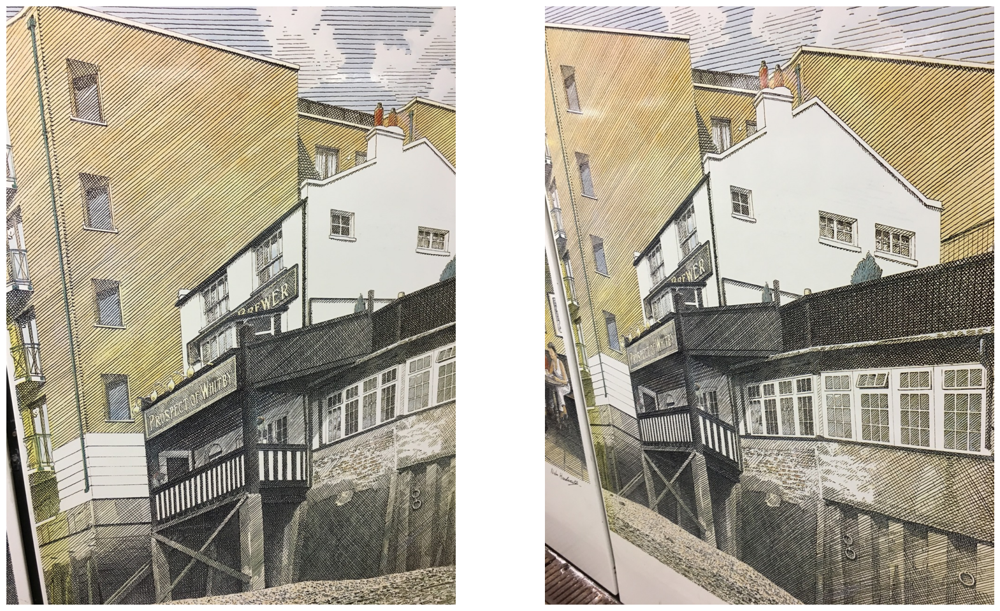

In [64]:
plot_images([batch['image1'][0], batch['image2'][0]], 
            nrows=1, ncols=2, figsize=(20, 15))

# Detect keypoints, calculate descriptors and match keypoints


In [65]:
with torch.no_grad():
    if detector is not None:
        detector.eval()
    
    if descriptor is not None:
        descriptor.eval()
    
    if end_to_end is not None:
        end_to_end.eval()

    kp1, kp_desc1 = get_features(detector, descriptor, end_to_end, batch['image1'], batch['grayscale_image1'], cfg.predict.evaluation.n)
    kp2, kp_desc2 = get_features(detector, descriptor, end_to_end, batch['image2'], batch['grayscale_image2'], cfg.predict.evaluation.n)

/opt/conda/lib/python3.11/site-packages/torch/nn/functional.py:4373: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


## Visualize keypoints

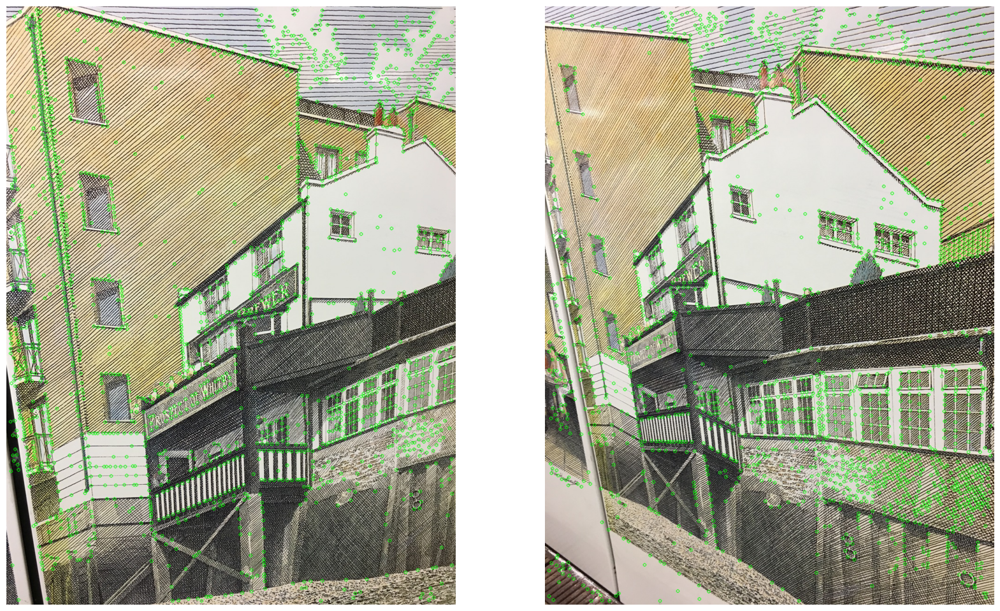

In [66]:
plot_keypoints([batch['image1'][0], batch['image2'][0]], 
               [kp1[0], kp2[0]], 
               nrows=1, ncols=2, figsize=(20, 15))

# Calculate classical metrics

In [99]:
kp_mask1 = torch.ones(kp1.shape[:2], dtype=torch.bool)
kp_mask2 = torch.ones(kp2.shape[:2], dtype=torch.bool)

_image_dims1 = torch.tensor(batch['image1'].shape[2:]).flip([-1])
_image_dims2 = torch.tensor(batch['image2'].shape[2:]).flip([-1])

_kp1 = (kp1 + batch['offset1']).flip([-1])
_kp2 = (kp2 + batch['offset2']).flip([-1])

_offset1 = batch['offset1'].flip([-1])
_offset2 = batch['offset2'].flip([-1])


## Repeatability

In [114]:
from source.evaluation.classical_metrics import repeatability, mean_matching_accuracy

repeatability(_kp1, _kp2,
              _offset1, _offset2,
              kp_mask1, kp_mask2,
              batch['h'],
              _image_dims1, _image_dims2,
              cfg.predict.evaluation.max_px_err_thr)

942 1248.0


array([[0.21474358, 0.46314102, 0.62580127, 0.693109  , 0.7099359 ,
        0.71955127, 0.72836536, 0.73477566, 0.7379808 , 0.744391  ]],
      dtype=float32)


### Visualize shared keypoints

In [115]:
from source.utils.common_utils import project
from source.evaluation.classical_metrics import is_inside_image_dims

_w_kp1 = project(_kp1, batch['h'])
_w_kp2 = project(_kp2, torch.inverse(batch['h']))

shared_kp_mask1 = is_inside_image_dims(_w_kp1, _offset2, _image_dims2)
shared_kp_mask2 = is_inside_image_dims(_w_kp2, _offset1, _image_dims1)

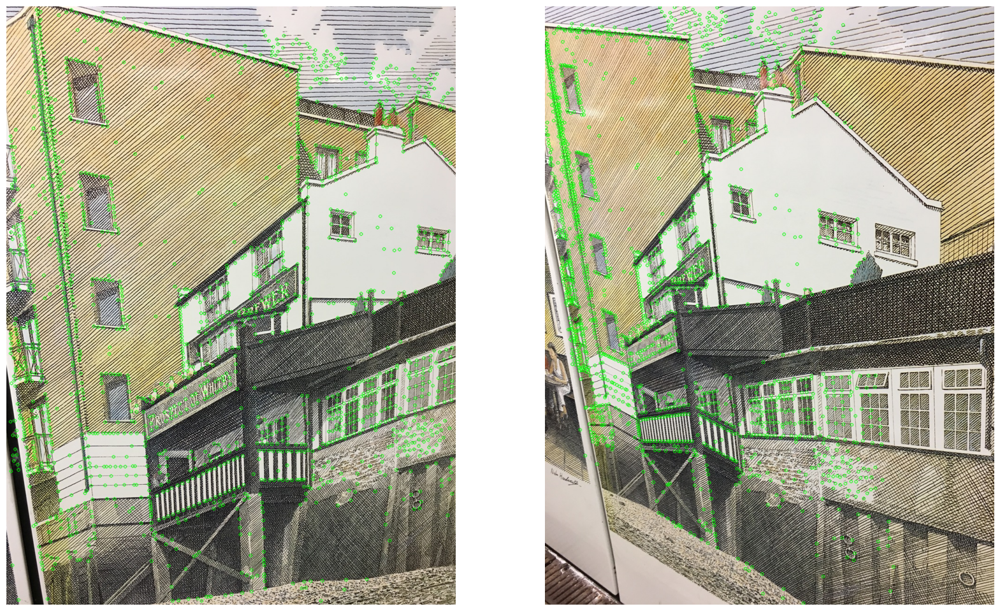

In [116]:
w_kp1 = _w_kp1.flip([-1]) - _offset2.flip([-1])

plot_keypoints([batch['image1'][0], batch['image2'][0]], 
               [kp1[0], w_kp1[0]],
               [shared_kp_mask1[0], shared_kp_mask1[0]],
               nrows=1, ncols=2, figsize=(20, 15))

Num shared keypoints: 1925  and  1248


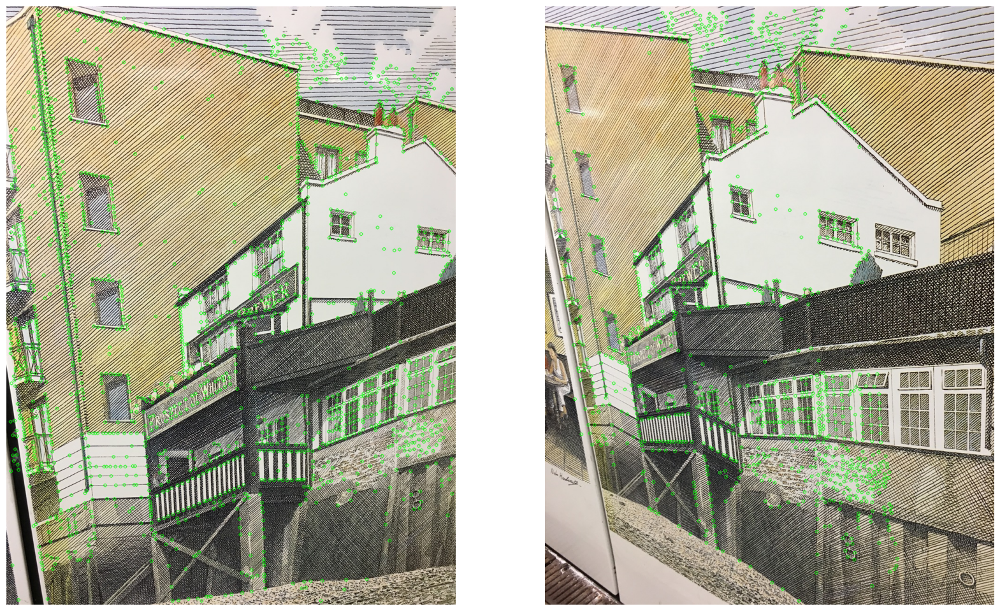

In [117]:
print("Num shared keypoints:", shared_kp_mask1.sum().item(), ' and ', shared_kp_mask2.sum().item())
plot_keypoints([batch['image1'][0], batch['image2'][0]], 
               [kp1[0], kp2[0]],
               [shared_kp_mask1[0], shared_kp_mask2[0]],
               nrows=1, ncols=2, figsize=(20, 15))

### Visualize non-shared keypoints

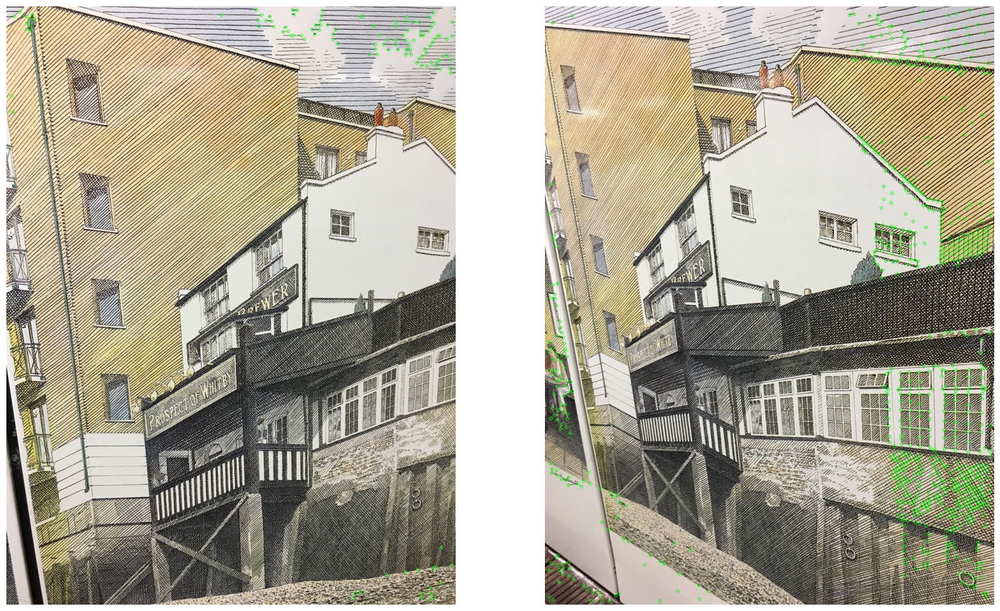

In [118]:
plot_keypoints([batch['image1'][0], batch['image2'][0]], 
               [kp1[0], kp2[0]],
               [~shared_kp_mask1[0], ~shared_kp_mask2[0]],
               nrows=1, ncols=2, figsize=(20, 15))

### Visualize correspondences

In [125]:
from source.evaluation.l2_matcher import get_mutual_match_mask

dist = torch.cdist(_w_kp1, _kp2)

nn_idx1 = dist.argmin(dim=-1)
nn_idx2 = dist.argmin(dim=-2)

mutual_match_mask = get_mutual_match_mask(nn_idx1, nn_idx2)
shared_match_mask = shared_kp_mask1 & mutual_match_mask & torch.gather(shared_kp_mask2.float(), -1, nn_idx1).bool()

_nn_kp2 = gather_kp(_kp2, nn_idx1)
proj_err = (_nn_kp2 - _w_kp1).norm(dim=-1)

px_thresh = 10.0
px_thr_kp_mask = shared_match_mask & (proj_err < cfg.predict.evaluation.max_px_err_thr)

Num correspondences: 929


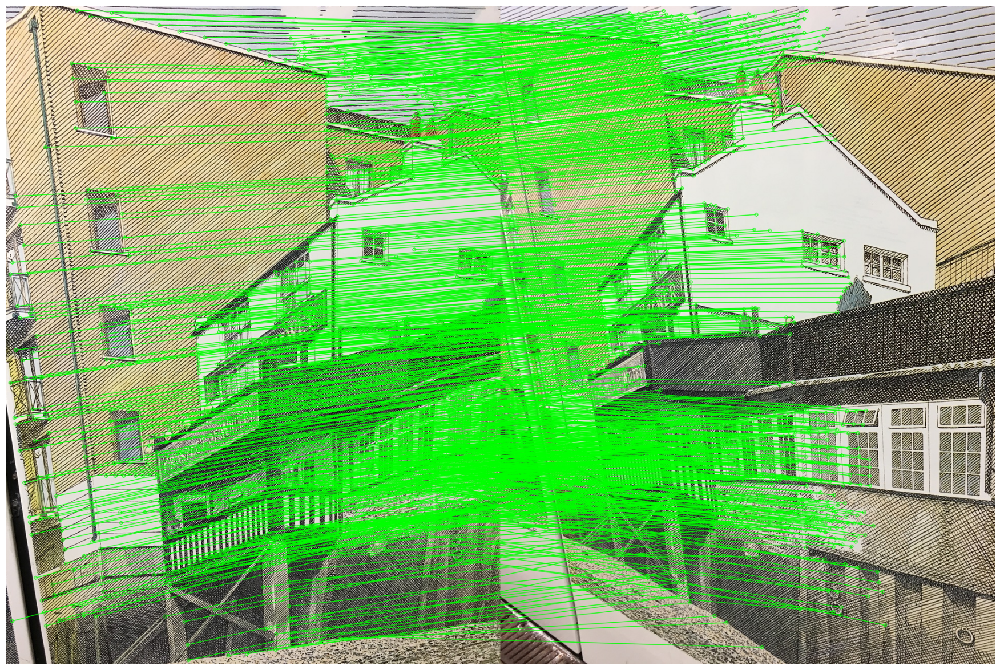

In [126]:
nn_kp2 = _nn_kp2.flip([-1]) - _offset2.flip([-1])

print("Num correspondences:", px_thr_kp_mask.sum().item())
plot_matches(batch['image1'][0], batch['image2'][0], 
             kp1[0], nn_kp2[0],
             px_thr_kp_mask[0])

## Mean matching accuracy

In [127]:
mean_matching_accuracy(_kp1,
                       _kp2,
                       kp_desc1, kp_desc2,
                       kp_mask1, kp_mask2,
                       batch['h'],
                       cfg.predict.evaluation.max_px_err_thr)

array([[0.3360161 , 0.57545274, 0.7525151 , 0.79275656, 0.7967807 ,
        0.7987928 , 0.8068411 , 0.8068411 , 0.8088531 , 0.8088531 ]],
      dtype=float32)

### Visualize mutual matches

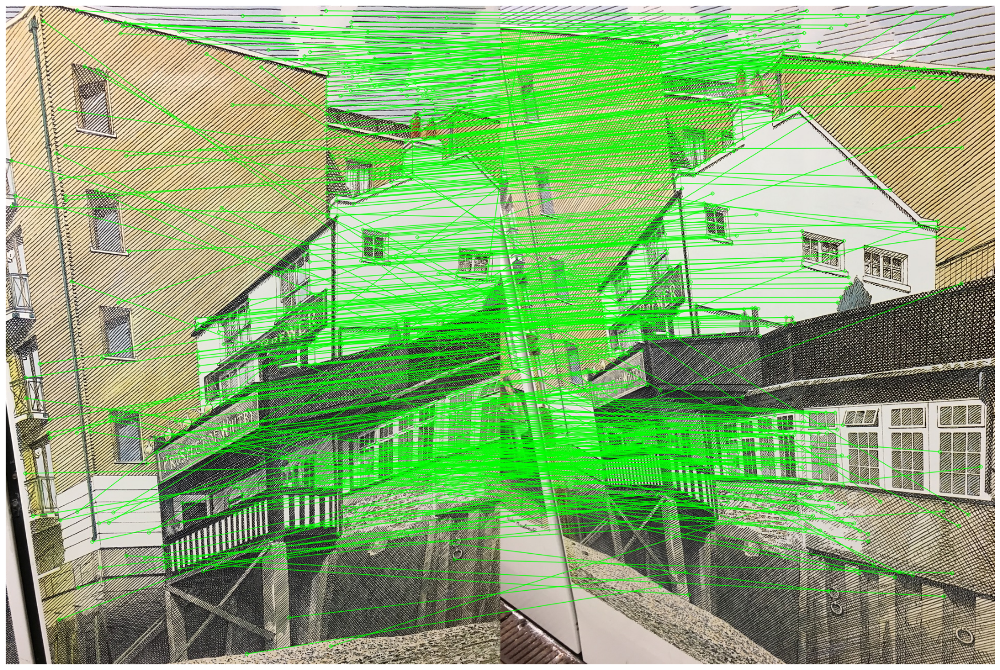

In [128]:
matcher = L2Matcher()

matches = matcher.match(kp_desc1, kp_desc2)
nn_kp2 = matches.gather_nn(kp2)

plot_matches(batch['image1'][0], batch['image2'][0], kp1[0], nn_kp2[0], matches.mutual_nn_match_mask1[0])

### Visualize correct mutual matches

In [129]:
correct_mutual_match_mask = (_nn_kp2 - _w_kp1).norm(dim=-1).le(cfg.predict.evaluation.max_px_err_thr) & matches.mutual_nn_match_mask1

Num correct matches: 448


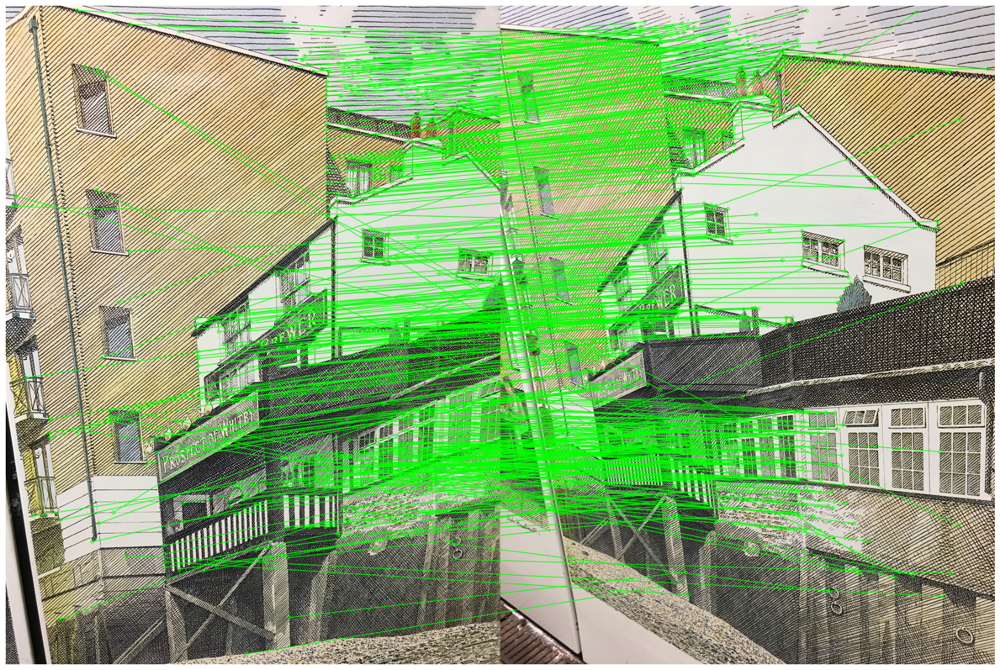

In [130]:
print("Num correct matches:", correct_mutual_match_mask.sum().item())
plot_matches(batch['image1'][0], batch['image2'][0], kp1[0], nn_kp2[0], correct_mutual_match_mask[0])